In [257]:
import pandas as pd
import numpy as np
import os
import json
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.graph_objects as go
from scipy.spatial.transform import Rotation as R

In [237]:
BASE_DIR = 'data/3d-object-detection-for-autonomous-vehicles/'

In [238]:
train = pd.read_csv(os.path.join(BASE_DIR, 'train.csv'))
train.head()

,Id,PredictionString
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2680.2830359778527 698.1969292852777 -18.04776...
1,edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e...,1208.642684768659 1585.1812946970927 -23.56236...
2,1841b7895e7163a2c1be87e8c1740e759a910cd59157b8...,848.9346793681768 2587.2870557176507 -20.15995...
3,a970c764e7abd7ebc2cc4599a6e3ae58c9773ea3c9cf1d...,1994.4320280494098 1128.30164336183 -18.054752...
4,b909de93ba19460eeea58074ccc1ef6bb302435f37b48c...,1030.3877156973385 1667.13131694941 -23.764820...


In [239]:
object_columns = ['sample_id', 'object_id', 'center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw', 'class_name']
objects = []
for sample_id, ps in train.values[:]:
    object_params = ps.split()
    n_objects = len(object_params)
    for i in range(n_objects // 8):
        x, y, z, w, l, h, yaw, c = tuple(object_params[i * 8: (i + 1) * 8])
        objects.append([sample_id, i, x, y, z, w, l, h, yaw, c])
train_objects = pd.DataFrame(objects, columns=object_columns)

In [240]:
numerical_cols = ['object_id', 'center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw']
train_objects[numerical_cols] = np.float32(train_objects[numerical_cols].values)
train_objects.head()

,sample_id,object_id,center_x,center_y,center_z,width,length,height,yaw,class_name
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,0.0,2680.282959,698.196899,-18.047768,2.064,5.488,2.053,2.604164,car
1,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,1.0,2691.997559,660.801636,-18.674259,1.818,4.570,1.608,-0.335176,car
2,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2.0,2713.607422,694.403503,-18.589972,1.779,4.992,1.620,2.579456,car
3,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,3.0,2679.986816,706.910156,-18.349594,1.798,3.903,1.722,2.586166,car
4,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,4.0,2659.352051,719.417480,-18.442999,1.936,4.427,1.921,2.601799,car


# db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce..
분석

In [241]:
def check_file(file):
    file_path = os.path.join(BASE_DIR, 'train_data', f'{file}.json')

    with open(file_path, 'r') as f:
        data = json.load(f)
    df = pd.DataFrame(data)
    return df

In [242]:
sample_data = check_file('sample_data')
calibrated_sensor = check_file('calibrated_sensor')
sensor = check_file('sensor')
sample_data.head()

,is_key_frame,prev,fileformat,token,timestamp,next,ego_pose_token,sample_token,filename,calibrated_sensor_token,width,height
0,True,d190078ec7869ad5c9e5417371aa3b45eb1c22804a0a29...,bin,ad87e1763749cc8562cca68e2046db128185c80c3e7599...,1.549921e+15,8182fb6868baf63c245a4994b7f3034a7d281d1928a784...,d90d278f2084ae64c98b0aa2dd8d4f83c023f1313beeae...,fd5f1c634b59e3b4e0f7a5c48c768a7d334a63221fced3...,lidar/host-a007_lidar1_1233956183701948366.bin,3b463530b5bae9698c9cc803c1731c36abd359a7296e23...,NaN,NaN
1,True,83f6f61cb6f2fc9b985cc23bd5613219eee7da390cd083...,bin,ea079138d89f3887b2bfcddfe16b747e2ec7a366ce66b3...,1.551742e+15,c291c5e9c1c70363496e304e964a33036cace6d14c177e...,97c348ec54ca0cfc892361595513d34d19e53583f97832...,c60dc70e93949cbefdda68813cf024fe8e9103bc8a68d6...,lidar/host-a008_lidar1_1235777221601281486.bin,2dba2d3171d7c60b847d65d96babfd7efb487428fa5a3c...,NaN,NaN
2,True,44555daed204fea486ec10ea1747432501b9f06fe93041...,jpeg,454c65ee6c297d64b17852b4c56def9781a84dcb8558a8...,1.550705e+15,d4b751751ca5424375d0faf3d22b9af83e7c84e1598ba0...,dce9c81e168db4f6fa442cc0bd484a4926dfe73946ba59...,254cea140f7d14fc86e73f789794fb73f81c05831d40f3...,images/host-a007_cam6_1234740264650905006.jpeg,30fcfa36375c0d36fce508cd04c9b1dd07ac283eb87352...,2048.0,864.0
3,True,de75f3f347742035f2442f4a5fa0334946642daa2d07d8...,jpeg,779018e1f92debcf5c5c28e9577677c6595679780bdf9b...,1.546901e+15,4796998aae092f295fe4f96ce57fc673e3292c7b0368ac...,bb93bbeb3b6d151c805729dba52d4c0c0070f20376090b...,810503d8ca51e9692021ecb56e2b2f2098beaf396cd207...,images/host-a007_cam3_1230936242299360006.jpeg,76e7bb72dd96cb18f5c75abae3b5bab5e41bd4aac39445...,1224.0,1024.0
4,True,a208568472ef6719faa2540622ada30b004583de9153f4...,jpeg,d966960819eb0aca2883cd3c8d8c5e2540bda952a8cada...,1.549650e+15,1a82a24dafde93234579ae59f48498a8436361cc641a64...,53f6821330f6bc07603db70fde1a96b25bd919471e923c...,119b8c4bbaf1493bebaaa7d823934a8a3f5a80fb095630...,images/host-a004_cam2_1233685223917652006.jpeg,aac6241dd5e28264de261422696af2037868c5133d9329...,1224.0,1024.0


In [243]:
sample_data_object = sample_data[sample_data['sample_token'] == train_objects['sample_id'].values[0]]
sample_data_object.head(15)

,is_key_frame,prev,fileformat,token,timestamp,next,ego_pose_token,sample_token,filename,calibrated_sensor_token,width,height
2981,True,f1c11f633b14f1d6405ce6dc83d5aa7dc4786ac1bad505...,jpeg,bf374e60b6a1b0b9d4c0e3cf9e92b1f5d8401eae774ec1...,1.558110e+15,000a8a46b2868cfa04c4d0ceaa4e082ac7bfa7eecfce8c...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam0_1242144892450000006.jpeg,8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de8...,1920.0,1080.0
20291,True,082a8c0bd8d08bbea9e1ad0881586f7049aed7e7aa0faf...,jpeg,521ca50fff810fcb6f70170f6a6b48709e55164902e34d...,1.558110e+15,e3923107b80a531619c534c32fe64eb2215c3399eb813e...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam4_1242144892416660006.jpeg,8868ef421e2c716ac3df7b2e29ebea5a50156d1ae83c52...,1920.0,1080.0
30149,True,b5ecc12ad66abc7be6515d8813d39bf7dd2130743ebec7...,jpeg,e35731e7cc91018cbafd323f635d97ccbd948642c19937...,1.558110e+15,48b9a0898c2818bffb160e77d0f6cdeddd04c6a74810bf...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam1_1242144892466660006.jpeg,be1d17a7d10692b4bfa8f90d19d7511ed4a49e10ff7366...,1920.0,1080.0
39603,True,929bf0caaa9c335b8fae52d119d767053226e947f325b8...,jpeg,762f245c3f3a0cfe3a9bc97eb321eb71522eaff0904469...,1.558110e+15,4218180552c23d4cf1d14a3ac9775ce484afc16b7284a3...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam3_1242144892500000006.jpeg,59155106c0ac5abe83cb6558ad8ce98400e3c3abf51234...,1920.0,1080.0
80267,True,16b78d5bedbced566516dc3468eadf0d0fef7ecf149713...,jpeg,89ef38638f8f4cbd932f693e934c4022681de809417a50...,1.558110e+15,9d519fd15258deeb06a40b13bdc6827a0df8fa33953e7e...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam2_1242144892483330006.jpeg,18908cc236587364dfac3766d0a410ef598e41a417e1cf...,1920.0,1080.0
116938,True,f756a344b625bc2a932e4873af6d961afa84a5bb331392...,bin,0d3a497e9c99f8a4697e0e9d2644a8a7e3bd20143b58db...,1.558110e+15,c6cb4cef7b50bc7f733ad091aa73bd9833fde0362def2c...,e36a9a1c02de786a9ac136640955071e1eda14659f5c75...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,lidar/host-a101_lidar2_1242144892502687076.bin,dd9aad0c2aa0c75b9b0e227b568f64aac54f72c67956e7...,NaN,NaN
125342,True,24d54b61bde15d16134bc3b26a99dbe1a53610b0bf51b9...,jpeg,a8b62cfacbdb74d34051f2ace4e3e89c8eb19bab1c8830...,1.558110e+15,b8d65798a023e0b4e71c55a3230c747a503c080dff2c26...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam5_1242144892433330006.jpeg,c63ee9e8447236363329b16551200c1216313f3e110797...,1920.0,1080.0
139211,True,d8c2b6f50e7994c708174f077eaca66c92e7358a3cee6d...,bin,f2f0d25a268a7a7112be881669bf0b4848ae591c8c70de...,1.558110e+15,a035b707c04a511ce924bdab277378a152467c77805765...,e36a9a1c02de786a9ac136640955071e1eda14659f5c75...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,lidar/host-a101_lidar1_1242144892502687076.bin,82130f5d48b806b62fec95989081337218fbf338ebcc95...,NaN,NaN
156484,True,c125f14d1fb4271fcd0875bfed25c4301f3d293bc4cf50...,bin,cc0c6d32e941040f2e4a384ab9707516ca39d36b9f66ba...,1.558110e+15,f770104a6bbeab45c445e5e255f9fc0a3d3816fac2209f...,e36a9a1c02de786a9ac136640955071e1eda14659f5c75...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,lidar/host-a101_lidar0_1242144892502687076.bin,7575ccf88b92f9aab15b49679e86f1b03cf8050cf9b2b3...,NaN,NaN
159086,True,b6f39c4c4783e6578f3f7179ababb2316f5837b5a89657...,jpeg,2968bff405ae8834b9d2e12ce2a004a70a6b1d99b6e933...,1.558110e+15,426fea6c8a3d06996f6e5ed45256eeb83690a4765c74ec...,dfba284cabe099bbe89ff13355a7702828d02709f82579...,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,images/host-a101_cam6_1242144892450000006.jpeg,4f30ede5a14a2644e870ae98a0f140c6c8e2d1507ecb82...,1920.0

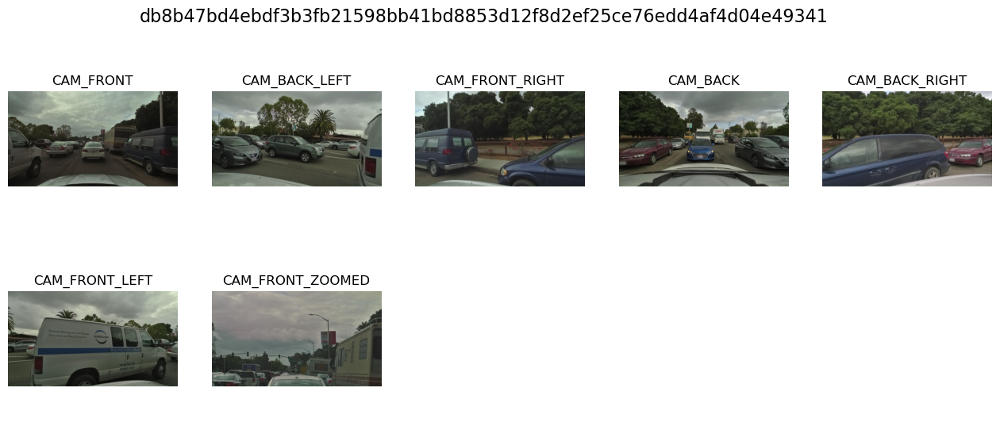

In [244]:
fig, ax = plt.subplots(2, 5, figsize=(16, 6))
fig.suptitle(sample_data_object['sample_token'].values[0], fontsize=16)

jpeg_objects = sample_data_object[sample_data_object['filename'].str.endswith('.jpeg')]
for idx, i in enumerate(jpeg_objects['filename'].values):
    i = i.split('/')[-1]
    img = plt.imread(os.path.join(BASE_DIR, 'train_images', i))
    ax[idx // 5, idx % 5].imshow(img)
    ax[idx // 5, idx % 5].axis('off')
for i in range(len(jpeg_objects['filename'].values), 10):
    ax[i // 5, i % 5].axis('off')
for idx, i in enumerate(jpeg_objects['calibrated_sensor_token'].values):
    calibrated_sensor_data = calibrated_sensor[calibrated_sensor['token'] == i]
    sensor_data = sensor[sensor['token'] == calibrated_sensor_data['sensor_token'].values[0]]
    ax[idx // 5, idx % 5].set_title(sensor_data['channel'].values[0])
    
plt.show()

In [245]:
bin_objects = sample_data_object[sample_data_object['filename'].str.endswith('.bin')]
print(bin_objects['filename'].values)

['lidar/host-a101_lidar2_1242144892502687076.bin'
 'lidar/host-a101_lidar1_1242144892502687076.bin'
 'lidar/host-a101_lidar0_1242144892502687076.bin']


In [246]:
def visualize_lidar_plotly(points):
    fig = go.Figure(data=[
        go.Scatter3d(
            x=points[:, 0],
            y=points[:, 1],
            z=points[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=points[:, 3],  # Intensity
                colorscale='Viridis',
                opacity=0.5
            )
        )
    ])
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='manual',
            aspectratio=dict(x=200, y=200, z=15),
            camera=dict(
                eye=dict(x=0, y=0, z=20)
            )
        ),
        margin=dict(l=0, r=0, b=0, t=0)
    )
    fig.show()

def load_lidar_data(file_path):
    lidar_data = np.fromfile(file_path, dtype=np.float32)
    lidar_data = lidar_data.reshape(-1, 5)
    return lidar_data


In [247]:
for i in bin_objects['filename']:
    print(i)
    bin_data = bin_objects[bin_objects['filename'] == i]
    calibrated_sensor_data = calibrated_sensor[calibrated_sensor['token'] == bin_data['calibrated_sensor_token'].values[0]]
    sensor_data = sensor[sensor['token'] == calibrated_sensor_data['sensor_token'].values[0]]
    print(sensor_data['channel'].values)
    i = i.split('/')[-1]
    lidar_points = load_lidar_data(os.path.join(BASE_DIR, 'train_lidar', i))
    visualize_lidar_plotly(lidar_points)

lidar/host-a101_lidar2_1242144892502687076.bin
['LIDAR_FRONT_RIGHT']


lidar/host-a101_lidar1_1242144892502687076.bin
['LIDAR_TOP']


lidar/host-a101_lidar0_1242144892502687076.bin
['LIDAR_FRONT_LEFT']


# host-a101_lidar1_1242144892502687076.bin 에 대해 Object Detection 수행

In [248]:
lidar_points = load_lidar_data(os.path.join(BASE_DIR, 'train_lidar', 'host-a101_lidar1_1242144892502687076.bin'))
visualize_lidar_plotly(lidar_points)

In [249]:
object_axis = train_objects[train_objects['sample_id'] == sample_data_object[sample_data_object['filename'] == 'lidar/host-a101_lidar1_1242144892502687076.bin']['sample_token'].values[0]]
print(object_axis)

                                            sample_id  object_id     center_x  \
0   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        0.0  2680.282959   
1   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        1.0  2691.997559   
2   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        2.0  2713.607422   
3   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        3.0  2679.986816   
4   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        4.0  2659.352051   
5   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        5.0  2705.199463   
6   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        6.0  2712.706299   
7   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        7.0  2755.555176   
8   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        8.0  2721.868164   
9   db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...        9.0  2723.602295   
10  db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...       10.0  2683.980225   
11  db8b47bd4ebdf3b3fb21598b

In [250]:
def visualize_lidar_with_bounding_boxes(points, bounding_boxes):
    fig = go.Figure(data=[
        go.Scatter3d(
            x=points[:, 0],
            y=points[:, 1],
            z=points[:, 2],
            mode='markers',
            marker=dict(
                size=1,
                color=points[:, 3],
                colorscale='Viridis',
                opacity=0.5
            )
        )
    ])

    for box in bounding_boxes:
        cx, cy, cz, w, l, h, yaw = box
        corners = get_bounding_box_corners(cx, cy, cz, w, l, h, yaw)
        fig.add_trace(
            go.Mesh3d(
                x=corners[:, 0],
                y=corners[:, 1],
                z=corners[:, 2],
                color='red',
                opacity=0.3,
                alphahull=0
            )
        )
    
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='manual',
            aspectratio=dict(x=200, y=200, z=15),
            camera=dict(
                eye=dict(x=2800, y=700, z=-18)
            )
        ),
        margin=dict(l=0, r=0, b=0, t=0)
    )
    fig.show()

def get_bounding_box_corners(cx, cy, cz, w, l, h, yaw):
    R = np.array([
        [np.cos(yaw), -np.sin(yaw), 0],
        [np.sin(yaw), np.cos(yaw), 0],
        [0, 0, 1]
    ])
    corners = np.array([
        [-w / 2, -l / 2, -h / 2],
        [w / 2, -l / 2, -h / 2],
        [w / 2, l / 2, -h / 2],
        [-w / 2, l / 2, -h / 2],
        [-w / 2, -l / 2, h / 2],
        [w / 2, -l / 2, h / 2],
        [w / 2, l / 2, h / 2],
        [-w / 2, l / 2, h / 2],
    ])
    rotated_corners = (R @ corners.T).T
    translated_corners = rotated_corners + np.array([cx, cy, cz])
    return translated_corners


In [265]:
bounding_volumes_array = np.array(object_axis[['center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw']].values)

# 카메라 위치 변환
bin_name = 'lidar/host-a101_lidar1_1242144892502687076.bin'
ego_pose = check_file('ego_pose')
ego_pose_token = sample_data_object[sample_data_object['filename'] == bin_name]['ego_pose_token'].values[0]
ego_pose_data = ego_pose[ego_pose['token'] == ego_pose_token]
translation = ego_pose_data['translation'].values[0]
print(translation)
rotation = ego_pose_data['rotation'].values[0]
print(rotation)

quat = np.array(rotation)
r = R.from_quat(quat)
yaw = r.as_euler('zyx')[0]
rotation_matrix = np.array([
    [np.cos(yaw), -np.sin(yaw), 0],
    [np.sin(yaw), np.cos(yaw), 0],
    [0, 0, 1]
])

# bounding_volumes_array[:, 0:3] = np.dot(bounding_volumes_array[:, 0:3], rotation_matrix.T)
bounding_volumes_array[:, 0:3] = bounding_volumes_array[:, 0:3] - translation
print(bounding_volumes_array[:, 0:3])


[2706.450326057957, 694.5009240389063, -19.2608892925368]
[0.2781972991626702, -3.898219099753236e-05, 0.010984161409140786, 0.9604611441474988]
[[-2.61673679e+01  3.69597530e+00  1.21312165e+00]
 [-1.44527674e+01 -3.36992874e+01  5.86630106e-01]
 [ 7.15709591e+00 -9.74206179e-02  6.70917749e-01]
 [-2.64635105e+01  1.24092321e+01  9.11295176e-01]
 [-4.70982742e+01  2.49165573e+01  8.17890406e-01]
 [-1.25086319e+00 -6.89557743e+00  1.12480187e+00]
 [ 6.25597286e+00 -3.60505009e+00  8.29092264e-01]
 [ 4.91048508e+01 -4.82014236e+01  1.21947312e+00]
 [ 1.54178381e+01 -9.34131718e+00  1.61933541e+00]
 [ 1.71519680e+01 -1.43342371e+01  1.96192575e+00]
 [-2.24701023e+01  1.79755173e+01  5.66679239e-01]
 [-1.65941257e+01  1.04482336e+01  9.12485361e-01]
 [ 1.69925442e+01 -1.95623856e+01  1.28336549e+00]
 [-4.89392948e+00 -7.83577859e-01  1.24740434e+00]
 [-1.99288425e+01  8.15380001e+00  8.14106226e-01]
 [-3.34100418e+01  8.13585567e+00  1.17969537e+00]
 [ 2.21942043e+01 -3.12987747e+01  1.07

In [266]:
visualize_lidar_with_bounding_boxes(lidar_points, bounding_volumes_array)